<h1>Networks of friends<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"></ul></div>

### Studying data from [Steam](https://store.steampowered.com)

by Sebastian Wolf

# Setup

In [1]:
# Make sure script changes take effect within this session
%load_ext autoreload
%autoreload 2

In [2]:
# import some useful packages for this analysis, start spark session
from setup import *

In [3]:
spark

Open localhost:4040 to monitor the spark UI

# Load csv

In [5]:
spark_handler.load('Friends')
friends = spark_handler.dfraw['Friends']

Number of records 

Player_Summaries : 5000000
Games_Publishers : 18761
Games_Genres : 39669
Games_Developers : 19333
Games_1 : 15426029
Games_2 : 29711963
Friends : 16450558
Groups : 3383666
App_ID : 17783


# Exploring the context
- Geographic distribution of gamers
- Evolution of gamers on steam
- When gamers are active

## The Steam dataset includes gamers from the entire world

- Yet, most steam users report their location to be in the United States and Russia
- *Explore user counts per country by hovering over the map*.

In [23]:
player_location = player_summaries.groupby('loccountrycode').count().toPandas()

In [24]:
world_borders = gpd.read_file(os.path.join(path, '../geo_files/TM_WORLD_BORDERS-0.3.shp'))

In [25]:
map_df = world_borders.merge(player_location, how = 'left', left_on = 'ISO2', right_on = 'loccountrycode')

In [26]:
map_df['player_density'] = map_df['count'] / map_df.AREA
map_df['player_per_cap'] = map_df['count'] / map_df.POP2005 * 100

In [27]:
map_df = map_df.replace(np.inf, 0).fillna(0)

In [28]:
m = folium.Map(location=[50, 0],
    tiles='CartoDB positron',
    zoom_start=1.5,
    control_scale = True)

colorscale_t = branca.colormap.linear.YlOrRd_09.scale(0, 100000)
colorscale_t.caption = '# of players registered'

folium.GeoJson(map_df, name='players per country', 
    style_function=lambda x: {"weight": 0.2, 'color': 'black', 'fillColor':colorscale_t(x['properties']['count']), 'fillOpacity':0.9},
    highlight_function=lambda x: {'weight':1, 'color':'black'},
    smooth_factor=1.0,
    show = True,
    tooltip=folium.features.GeoJsonTooltip(fields = ['NAME','count', 'player_density', 'player_per_cap'],
                                              aliases=['Country','Number of Players', 'Players / 10 sqkm', 'Players / 100 people' ], 
                                              labels=True, 
                                              sticky=True,
                                              localize=True
                                             )).add_to(m)
folium.LayerControl().add_to(m)
colorscale_t.add_to(m, 'scale')
m.save(os.path.join(git, '../html_maps/players_per_country.html'))

m

## Steam gaming is social

- The number of new friendships is proportional to the number of new users
- We see 2-3 times as many new friendships as new users per day

In [29]:
new_player_count = player_signup.groupby('month_created').count().toPandas().set_index('month_created').sort_index()

In [49]:
new_friendship_count = friends.where((F.col('friend_since_month') > dt.datetime(2009,1,1)) & \
                    (F.col('friend_since_month') < dt.datetime(2013,4,1))).groupby('friend_since_month').count().toPandas().set_index('friend_since_month').sort_index()

In [50]:
plt.rcParams.update({'axes.titlesize': 25,
                     'axes.labelsize' : 20,
                     'legend.fontsize' : 20,
                     'xtick.labelsize' : 18,
                     'ytick.labelsize' : 18,})

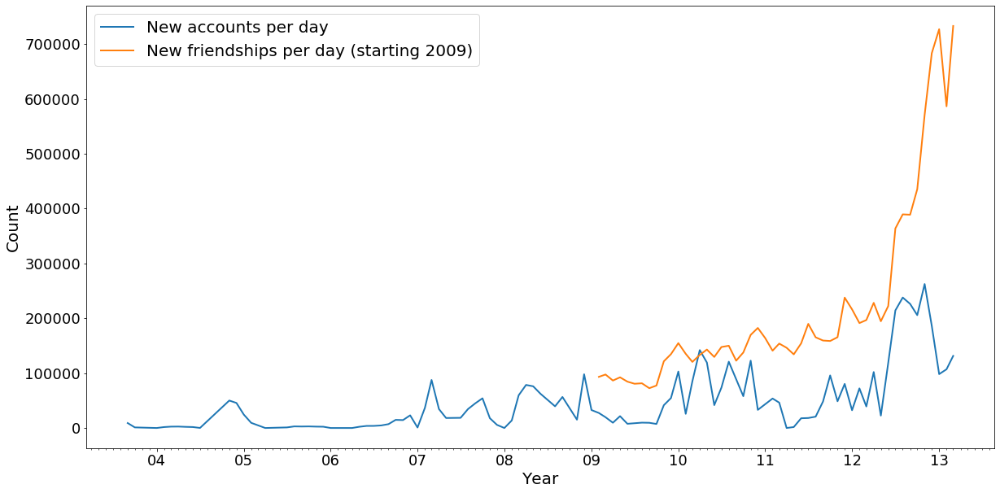

In [51]:
# Summary plots by day

# Set up frame
fig, axes = plt.subplots(nrows=1,ncols=1, figsize = (20, 10))
fig.subplots_adjust(hspace = 0.4)

# plot
sns.lineplot(x = new_player_count.index, y = new_player_count.values[:,0], ax = axes, label = 'New accounts per day',  linewidth = 2)
sns.lineplot(x = new_friendship_count.index, y = new_friendship_count.values[:,0], ax = axes, label = 'New friendships per day (starting 2009)',  linewidth = 2)


axes.set(ylabel = 'Count', xlabel = 'Year')
axes.xaxis.set_major_locator(mdates.YearLocator())
axes.xaxis.set_major_formatter(mdates.DateFormatter('%y'))
axes.xaxis.set_minor_locator(mdates.MonthLocator(interval=1))
axes.legend(loc='upper left')

plt.show()

## Gamers are more active on weekends and mornings

- The figure shows the day of the week and the hour when gamers sign up for Steam
- We see heightened activity from Saturday morning to Monday morning

In [52]:
dfs, style_dfs = crosstab_list_count(player_signup.where((F.col('dayofweek_created').isNull() == False) & (F.isnan('dayofweek_created') == False)),
                                      main_var = 'dayofweek_created',
                                      list_of_pivot_vars = ['hour_created'],
                                      title = "Total number of new accounts created by day of week and ")

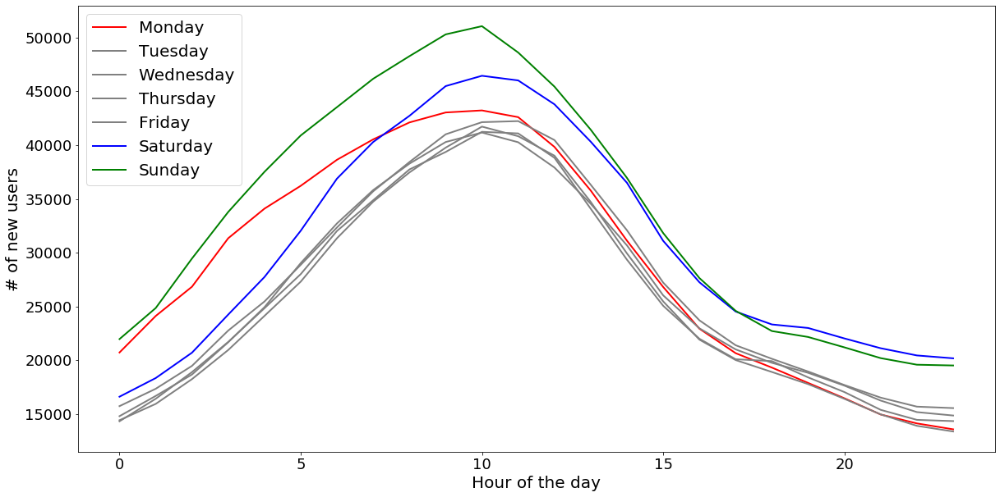

In [54]:
# Summary plots by day

# Set up frame
fig, axes = plt.subplots(nrows=1,ncols=1, figsize = (20, 10))

# plot
signup_times = dfs['hour_created'].transpose()
signup_times.columns = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
signup_times.plot(ax = axes, linewidth = 2, color = ['red', 'grey', 'grey', 'grey', 'grey','blue', 'green'])

axes.set(ylabel = '# of new users', xlabel = 'Hour of the day')
axes.legend(loc='upper left')

plt.show()

In [55]:
style_dfs['hour_created']

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23
dayofweek_created,,,,,,,,,,,,,,,,,,,,,,,,
1,"20,712","24,111","26,832","31,342","34,095","36,218","38,641","40,540","42,115","43,042","43,233","42,606","39,839","35,783","31,119","26,809","22,926","20,648","19,307","17,880","16,454","14,946","14,116","13,566"
2,"14,412","15,932","18,235","20,946","24,119","27,304","31,342","34,746","37,464","39,771","41,727","40,832","39,022","34,727","29,931","25,468","21,908","20,008","18,899","17,768","16,401","14,957","13,890","13,366"
3,"14,313","16,409","18,892","21,698","24,832","28,003","32,019","34,880","37,742","39,369","41,241","41,093","38,825","34,088","29,350","25,058","21,991","20,085","19,911","18,395","17,032","15,379","14,445","14,331"
4,"14,790","16,674","18,663","21,668","24,928","29,029","32,721","35,825","38,279","40,294","41,175","40,272","37,919","34,552","30,678","26,029","22,960","21,000","19,750","18,820","17,630","16,241","15,168","14,850"
5,"15,722","17,339","19,468","22,754","25,457","28,868","32,343","35,709","38,432","41,012","42,140","42,238","40,476","36,321","32,086","27,216","23,704","21,386","20,126","18,942","17,688","16,515","15,676","15,540"
6,"16,600","18,336","20,696","24,241","27,735","32,039","36,887","40,296","42,730","45,495","46,455","46,023","43,803","40,327","36,501","31,101","27,244","24,522","23,321","22,993","22,021","21,111","20,438","20,172"
7,"21,960","24,851","29,457","33,788","37,520","40,902","43,537","46,180","48,280","50,307","51,070","48,617","45,448","41,444","36,958","31,822","27,636","24,587","22,707","22,155","21,191","20,189","19,576","19,505"


# Analyzing game addiction

- Define addiction for this analysis
- Explore correlations with engagement factors in 5 hypothesis
- Summarize findings
- Derive conclusions and suggest focus for further analysis

## Game addiction affects only a small fraction of gamers
- The median playtime among active gamers (users that were active in the 2 weeks prior to data retrieval) was only 30min per day 
- Yet, 25% of active gamers play nearly 2h per day
- We will focus on the 1% of all gamers that play more than 5h per day on average
- To learn about game addicition, we will explore correlations of playtime with several engagement factors

In [56]:
# Restrict to a subset of vars
user_summary_pd_subset = user_summary_pd.loc[:,['playtime_average_player', 
                                                'playtime_average_friends',
                                                'playtime_average_friends_max',
                                                'playtime_forever_player', 
                                                'playtime_forever_friends',
                                                'game_count_player', 
                                                'friend_count', 
                                                'group_count_player', 
                                                'multiplayer_fraction_player',
                                                'spending_player']]

In [57]:
# Remove implausible outliers
user_summary_pd_subset = user_summary_pd_subset[user_summary_pd_subset.playtime_average_player < 24]

In [58]:
pd.options.display.float_format = '{:,.4f}'.format

In [59]:
user_summary_pd_subset.describe()

,playtime_average_player,playtime_average_friends,playtime_average_friends_max,playtime_forever_player,playtime_forever_friends,game_count_player,friend_count,group_count_player,multiplayer_fraction_player,spending_player
count,"1,665,521.0000","217,832.0000","217,832.0000","1,665,521.0000","217,832.0000","1,665,521.0000","873,104.0000","431,942.0000","1,665,521.0000","1,665,521.0000"
mean,0.2813,1.0057,1.4484,"13,888.8125","50,349.3465",9.2606,13.7118,6.6285,0.6318,117.7021
std,1.0252,1.6848,2.3496,"31,654.5027","53,796.2542",24.4168,25.4832,15.9215,0.3582,302.7556
min,0.0000,0.0000,0.0000,0.0000,0.0000,1.0000,1.0000,1.0000,0.0000,0.0000
25%,0.0000,0.0000,0.0000,144.0000,"11,670.0000",1.0000,2.0000,1.0000,0.4000,14.9900
50%,0.0000,0.1607,0.2214,"1,862.0000","35,656.1667",3.0000,5.0000,2.0000,0.6923,34.9700
75%,0.0000,1.4131,2.1060,"12,599.0000","71,350.2500",7.0000,14.0000,6.0000,1.0000,84.9400
max,23.9952,24.9417,24.9417,"1,709,165.0000","1,709,165.0000","1,528.0000",674.0000,"1,511.0000",1.0000,"14,972.5600"


In [60]:
# Find 99th percentile
user_summary_pd_subset.playtime_average_player.quantile(0.99)

5.113095238095238

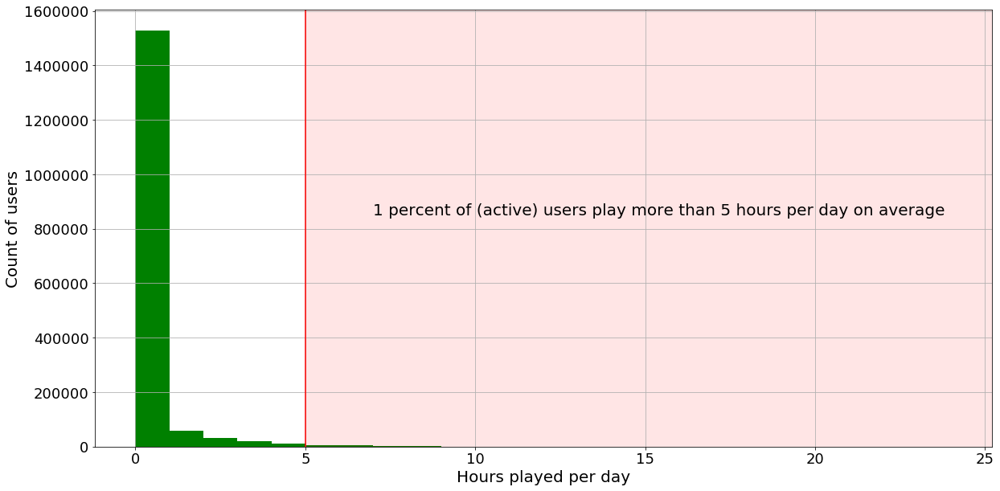

In [61]:
# Playtime histogram

# Set up frame
fig, axes = plt.subplots(nrows=1,ncols=1, figsize = (20, 10))

# plot
user_summary_pd_subset.playtime_average_player.hist(bins = 24, ax = axes, linewidth = 2, color = 'g')
axes.set(ylabel = 'Count of users', xlabel = 'Hours played per day')
axes.text(7, 850000, '1 percent of (active) users play more than 5 hours per day on average', fontsize = 20)
axes.axvline(x = 5, color ='r')
patch = matplotlib.patches.Polygon(np.array([[5,0],[5,1700000],[26,1700000],[26,0]]), color = 'r', alpha = 0.1)
axes.add_patch(patch)
plt.show()

In [62]:
# Restrict to 99th percentile
user_summary_pd_subset_addicted = user_summary_pd_subset[user_summary_pd_subset.playtime_average_player > 5]

In [63]:
user_summary_pd_subset_addicted.corr()

,playtime_average_player,playtime_average_friends,playtime_average_friends_max,playtime_forever_player,playtime_forever_friends,game_count_player,friend_count,group_count_player,multiplayer_fraction_player,spending_player
playtime_average_player,1.0000,0.0311,0.0526,0.2559,0.0209,0.0010,0.0213,0.0168,-0.0553,-0.0046
playtime_average_friends,0.0311,1.0000,0.8145,-0.0522,0.3686,-0.0976,0.0395,-0.0260,0.1347,-0.1098
playtime_average_friends_max,0.0526,0.8145,1.0000,0.0582,0.3450,-0.0431,0.3303,0.0533,0.0863,-0.0546
playtime_forever_player,0.2559,-0.0522,0.0582,1.0000,0.2668,0.2447,0.2968,0.1724,-0.1605,0.2478
playtime_forever_friends,0.0209,0.3686,0.3450,0.2668,1.0000,0.0912,0.1706,0.0767,-0.0635,0.0894
game_count_player,0.0010,-0.0976,-0.0431,0.2447,0.0912,1.0000,0.0853,0.0883,-0.3046,0.9870
friend_count,0.0213,0.0395,0.3303,0.2968,0.1706,0.0853,1.0000,0.3090,0.0640,0.0782
group_count_player,0.0168,-0.0260,0.0533,0.1724,0.0767,0.0883,0.3090,1.0000,-0.0392,0.0845
multiplayer_fraction_player,-0.0553,0.1347,0.0863,-0.1605,-0.0635,-0.3046,0.0640,-0.0392,1.0000,-0.3141
spending_player,-0.0046,-0.1098,-0.0546,0.2478,0.0894,0.9870,0.0782,0.0845,-0.3141,1.0000


In [64]:
user_summary_pd_subset.corr()

,playtime_average_player,playtime_average_friends,playtime_average_friends_max,playtime_forever_player,playtime_forever_friends,game_count_player,friend_count,group_count_player,multiplayer_fraction_player,spending_player
playtime_average_player,1.0000,0.2397,0.2921,0.4708,0.1079,0.2020,0.2837,0.0943,-0.0067,0.2178
playtime_average_friends,0.2397,1.0000,0.8808,0.1173,0.4190,0.0080,0.1089,0.0156,0.0165,0.0076
playtime_average_friends_max,0.2921,0.8808,1.0000,0.2258,0.4049,0.0459,0.3261,0.1020,0.0066,0.0456
playtime_forever_player,0.4708,0.1173,0.2258,1.0000,0.2875,0.3778,0.5178,0.2750,-0.0204,0.3992
playtime_forever_friends,0.1079,0.4190,0.4049,0.2875,1.0000,0.0822,0.2282,0.1032,-0.0253,0.0834
game_count_player,0.2020,0.0080,0.0459,0.3778,0.0822,1.0000,0.1962,0.0913,-0.1228,0.9816
friend_count,0.2837,0.1089,0.3261,0.5178,0.2282,0.1962,1.0000,0.4267,0.0203,0.1994
group_count_player,0.0943,0.0156,0.1020,0.2750,0.1032,0.0913,0.4267,1.0000,0.0009,0.0886
multiplayer_fraction_player,-0.0067,0.0165,0.0066,-0.0204,-0.0253,-0.1228,0.0203,0.0009,1.0000,-0.1114
spending_player,0.2178,0.0076,0.0456,0.3992,0.0834,0.9816,0.1994,0.0886,-0.1114,1.0000


## Hypothesis 1: The more friends I have, the more I play
- Heavy gamers have more friends than regular gamers: average = 40 vs 7 and median 20 vs 1
- There is a positive, but weak correlation of 0.3 between playtime and the number of friends
- However, among heavy gamers, the friend count does not correlate with playtime
- **Takeaway**: Heavy gamers generally have many friends on the network. But the number of friends does not correlate with their behaviour at the margin.

In [65]:
user_summary_pd_subset_addicted.friend_count.fillna(0).describe()

count   17,537.0000
mean        40.0153
std         52.4297
min          0.0000
25%          6.0000
50%         22.0000
75%         52.0000
max        674.0000
Name: friend_count, dtype: float64

In [66]:
user_summary_pd_subset.friend_count.fillna(0).describe()

count   1,665,521.0000
mean            7.1880
std            19.6804
min             0.0000
25%             0.0000
50%             1.0000
75%             5.0000
max           674.0000
Name: friend_count, dtype: float64

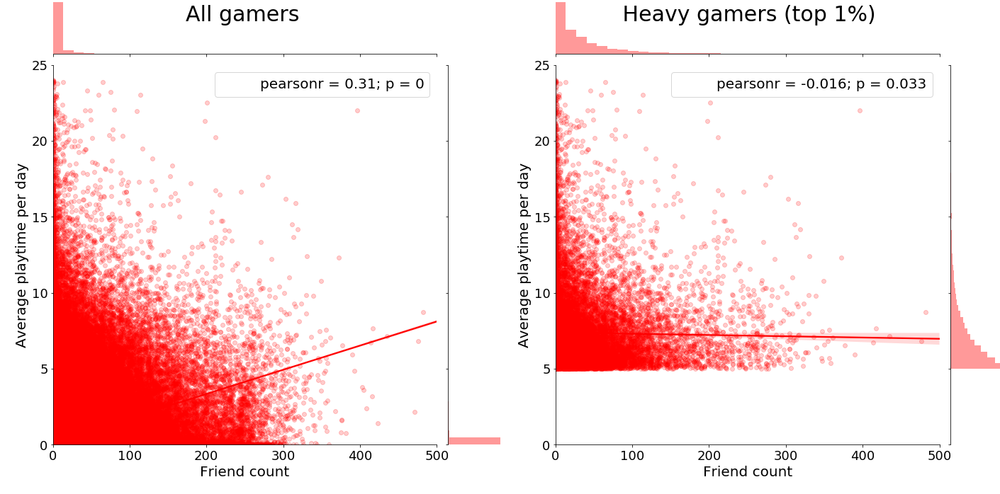

In [69]:
# Jointplot
g0 = sns.jointplot("friend_count", "playtime_average_player",  data=user_summary_pd_subset.fillna(0),
                  kind="reg", truncate=False,
                  color="r", height=7, ylim = (0,25), xlim = (0,500), marginal_kws=dict(kde=False),
                  joint_kws = {'scatter_kws':dict(alpha=0.2)})
g0.annotate(stats.pearsonr) 
g0.set_axis_labels('Friend count', 'Average playtime per day', fontsize=20)

g1 = sns.jointplot("friend_count", "playtime_average_player",  data=user_summary_pd_subset_addicted.fillna(0),
                  kind="reg", truncate=False, 
                  color="r", height=7, ylim = (0,25), xlim = (0,500), marginal_kws=dict(kde=False), 
                  joint_kws = {'scatter_kws':dict(alpha=0.2)})
g1.annotate(stats.pearsonr) 
g1.set_axis_labels('Friend count', 'Average playtime per day', fontsize=20)

fig = plt.figure(figsize=(20,10))
gs = gridspec.GridSpec(1, 2)

mg0 = SeabornFig2Grid(g0, fig, gs[0])
mg1 = SeabornFig2Grid(g1, fig, gs[1])

fig.suptitle('          All gamers                                                ' + \
             'Heavy gamers (top 1%) ', fontsize=30)


gs.tight_layout(fig)

plt.show()

## Hypothesis 2: The more my friends play...

- Heavy gamers' friends (if active) play more than regular gamers' friends (~2h vs 1h per day)
- The same holds for the median friend (1h45min vs 10min)
- For heavy gamers, playtime correlation with friends is only 0.03, vs 0.24 for the regular gamer
- **Takeaway**: Friends seem to be an influence, but less so at the margin.

In [70]:
user_summary_pd_subset_addicted.playtime_average_friends.describe()

count   8,341
mean        2
std         2
min         0
25%         0
50%         2
75%         3
max        22
Name: playtime_average_friends, dtype: float64

In [71]:
user_summary_pd_subset.playtime_average_friends.describe()

count   217,832
mean          1
std           2
min           0
25%           0
50%           0
75%           1
max          25
Name: playtime_average_friends, dtype: float64

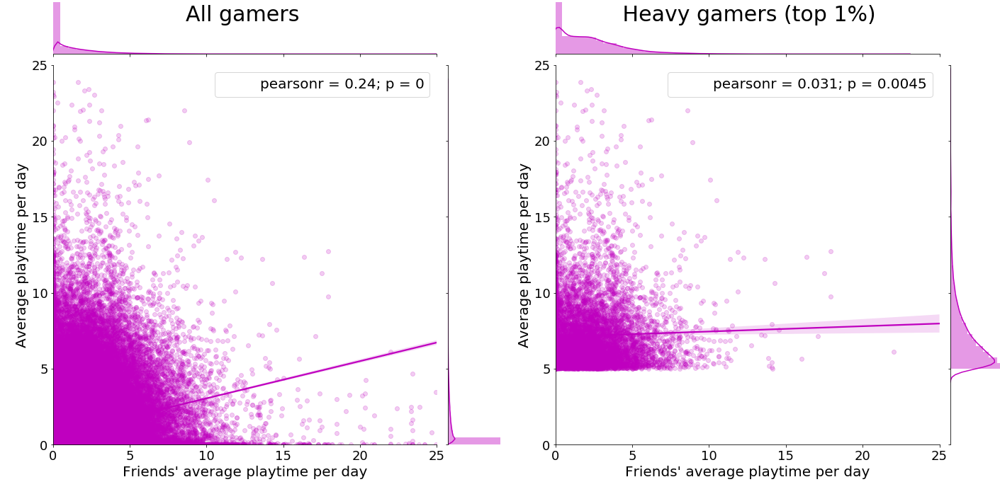

In [72]:
# Jointplot
g0 = sns.jointplot("playtime_average_friends", "playtime_average_player", data=user_summary_pd_subset,
                  kind="reg", truncate=False,
                  color="m", height=7, ylim = (0,25), xlim = (0,25), joint_kws = {'scatter_kws':dict(alpha=0.2)})
g0.annotate(stats.pearsonr) 
g0.set_axis_labels('Friends\' average playtime per day', 'Average playtime per day', fontsize=20)

g1 = sns.jointplot("playtime_average_friends", "playtime_average_player", data=user_summary_pd_subset_addicted,
                  kind="reg", truncate=False,
                  color="m", height=7, ylim = (0,25), xlim = (0,25), joint_kws = {'scatter_kws':dict(alpha=0.2)})
g1.annotate(stats.pearsonr) 
g1.set_axis_labels('Friends\' average playtime per day', 'Average playtime per day', fontsize=20)

fig = plt.figure(figsize=(20,10))
gs = gridspec.GridSpec(1, 2)

mg0 = SeabornFig2Grid(g0, fig, gs[0])
mg1 = SeabornFig2Grid(g1, fig, gs[1])

fig.suptitle('          All gamers                                                ' + \
             'Heavy gamers (top 1%) ', fontsize=30)


gs.tight_layout(fig)

plt.show()

## Hypothesis 3: The more my heaviest gamer friend plays...

- Correlation of playtime with the playtime of the friend that plays the most (0.29) is stronger than with the playtime of the average friend (0.24)
- But again, this correlation is weaker for the heavy gamers (0.05)
- **Takeaway**: The distribution of behaviour among friends matters. The maximum appears more important than the average.

In [73]:
user_summary_pd_subset_addicted.playtime_average_friends_max.describe()

count   8,341
mean        4
std         3
min         0
25%         1
50%         3
75%         5
max        24
Name: playtime_average_friends_max, dtype: float64

In [74]:
user_summary_pd_subset.playtime_average_friends_max.describe()

count   217,832
mean          1
std           2
min           0
25%           0
50%           0
75%           2
max          25
Name: playtime_average_friends_max, dtype: float64

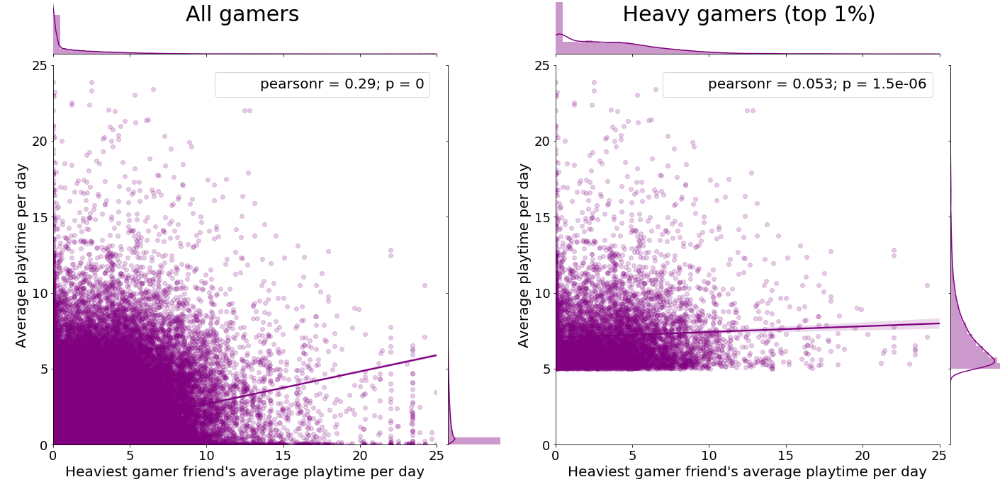

In [75]:
# Jointplot
g0 = sns.jointplot("playtime_average_friends_max", "playtime_average_player", data=user_summary_pd_subset,
                  kind="reg", truncate=False,
                  color="purple", height=7, ylim = (0,25), xlim = (0,25), joint_kws = {'scatter_kws':dict(alpha=0.2)})
g0.annotate(stats.pearsonr) 
g0.set_axis_labels('Heaviest gamer friend\'s average playtime per day', 'Average playtime per day', fontsize=20)


g1 = sns.jointplot("playtime_average_friends_max", "playtime_average_player", data=user_summary_pd_subset_addicted,
                  kind="reg", truncate=False,
                  color="purple", height=7, ylim = (0,25), xlim = (0,25), joint_kws = {'scatter_kws':dict(alpha=0.2)})
g1.annotate(stats.pearsonr) 
g1.set_axis_labels('Heaviest gamer friend\'s average playtime per day', 'Average playtime per day', fontsize=20)

fig = plt.figure(figsize=(20,10))
gs = gridspec.GridSpec(1, 2)

mg0 = SeabornFig2Grid(g0, fig, gs[0])
mg1 = SeabornFig2Grid(g1, fig, gs[1])

fig.suptitle('          All gamers                                                ' + \
             'Heavy gamers (top 1%) ', fontsize=30)


gs.tight_layout(fig)

plt.show()

## Hypothesis 4: The more groups I am part of...
- Rather than friends, it could be the diversity of groups that keeps users engaged
- Yet, group membership is uncommon: The median gamer is part of 0 groups vs 1 for heavy gamers
- Correlation with playtime is very low
- **Takeaway**: Groups seem to be less important than friends in understanding game addiction

In [76]:
user_summary_pd_subset_addicted.fillna(0).group_count_player.describe()

count   17,537
mean         7
std         26
min          0
25%          0
50%          1
75%          6
max      1,511
Name: group_count_player, dtype: float64

In [77]:
user_summary_pd_subset.fillna(0).group_count_player.describe()

count   1,665,521
mean            2
std             9
min             0
25%             0
50%             0
75%             1
max         1,511
Name: group_count_player, dtype: float64

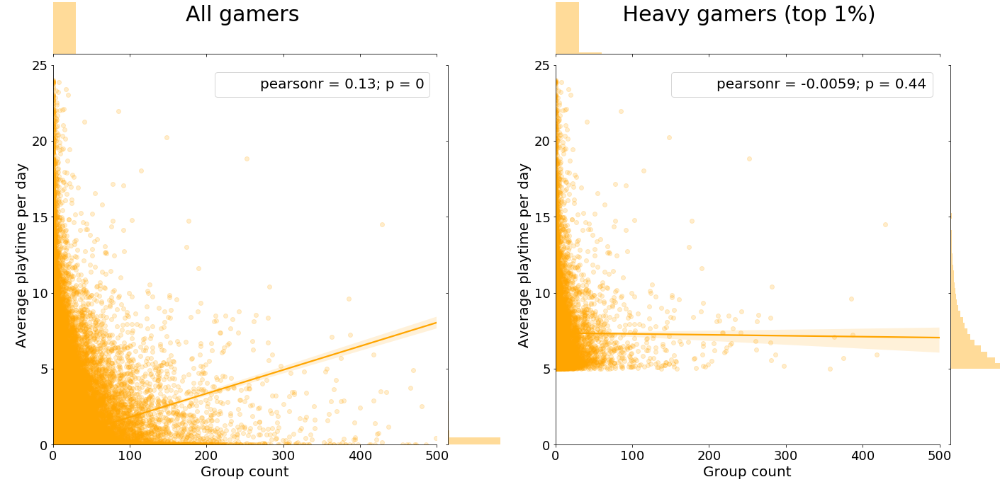

In [78]:
# Jointplot
g0 = sns.jointplot("group_count_player", "playtime_average_player",  data=user_summary_pd_subset.fillna(0),
                  kind="reg", truncate=False,
                  color="orange", height=7, ylim = (0,25), xlim = (0,500), marginal_kws=dict(kde=False),
                  joint_kws = {'scatter_kws':dict(alpha=0.2)})

g0.annotate(stats.pearsonr) 
g0.set_axis_labels('Group count', 'Average playtime per day', fontsize=20)


g1 = sns.jointplot("group_count_player", "playtime_average_player",  data=user_summary_pd_subset_addicted.fillna(0),
                  kind="reg", truncate=False,
                  color="orange", height=7, ylim = (0,25), xlim = (0,500), marginal_kws=dict(kde=False), 
                  joint_kws = {'scatter_kws':dict(alpha=0.2)})
g1.annotate(stats.pearsonr) 
g1.set_axis_labels('Group count', 'Average playtime per day', fontsize=20)

fig = plt.figure(figsize=(20,10))
gs = gridspec.GridSpec(1, 2)

mg0 = SeabornFig2Grid(g0, fig, gs[0])
mg1 = SeabornFig2Grid(g1, fig, gs[1])

fig.suptitle('          All gamers                                                ' + \
             'Heavy gamers (top 1%) ', fontsize=30)


gs.tight_layout(fig)

plt.show()

## Hypothesis 5: The more multiplayer games I play...
- It would seem that multiplayer games are more addictive, especially given the correlation of playtime and friends
- However, there is nearly no correlation between the fraction of multiplayer games played and playtime
- **Takeaway**: Regular gamers alike heavy gamers play a mix of single and multiplayer games

In [ ]:
# Jointplot
g0 = sns.jointplot("multiplayer_fraction_player", "playtime_average_player",  data=user_summary_pd_subset,
                  kind="reg", truncate=False,
                  color="blue", height=7, ylim = (0,25), xlim = (0,1), marginal_kws=dict(kde=False), 
                  joint_kws = {'scatter_kws':dict(alpha=0.2)})

g0.annotate(stats.pearsonr) 
g0.set_axis_labels('Fraction of games played that is multiplayer', 'Average playtime per day', fontsize=20)


g1 = sns.jointplot("multiplayer_fraction_player", "playtime_average_player",  data=user_summary_pd_subset_addicted ,
                  kind="reg", truncate=False,
                  color="blue", height=7, ylim = (0,25), xlim = (0,1), marginal_kws=dict(kde=False), 
                  joint_kws = {'scatter_kws':dict(alpha=0.2)})
g1.annotate(stats.pearsonr) 
g1.set_axis_labels('Fraction of games played that is multiplayer', 'Average playtime per day', fontsize=20)

fig = plt.figure(figsize=(20,10))
gs = gridspec.GridSpec(1, 2)

mg0 = SeabornFig2Grid(g0, fig, gs[0])
mg1 = SeabornFig2Grid(g1, fig, gs[1])

fig.suptitle('          All gamers                                                ' + \
             'Heavy gamers (top 1%) ', fontsize=30)


gs.tight_layout(fig)

plt.show()

## What we learn from correlations
- Several factors have been found to correlate with playtime:
    - The number of **friendships**
    - The **playtime of friends**
    - The **maximum playtime among friends**
    - The number of **group memberships**
- Correlation is not causation: We don't know whether the above factors cause addiction
- But we do know that these factors form important parts of heavy gamer's gaming experiences and need to be explored to understand addiction
- We also found that these factors seem to play a lesser role in explaining why heavy gamers play an hour more or less (low correlations at the margin)

## Correlations between playtime and engagement factors are lower for heavy gamers

In [ ]:
# Set up frame
fig, axes = plt.subplots(nrows=1,ncols=2, figsize = (15, 8), sharey = True)

sns.set(font_scale=1.2, style="white") 

# Generate a custom diverging colormap
cmap = sns.diverging_palette(220, 10, as_cmap=True)

labels = ['Avg playtime', 'Friends\' avg playtime', 'Friends\' max playtime', 'Player\'s total playtime', 'Friends\' total playtime', '# Games', '# Friends', '# Groups', 'Mulitplayer games' ]

# Compute the correlation matrix
corr = user_summary_pd_subset.drop(['spending_player'], axis = 'columns').corr()

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, cmap=cmap, center=0, vmax = 0.5, vmin = -0.3, 
            square=True, linewidths=.5, cbar_kws={"shrink": .5},
            xticklabels = labels, yticklabels = labels, ax = axes[0])

# Compute the correlation matrix
corr = user_summary_pd_subset_addicted.drop(['spending_player'], axis = 'columns').corr()

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, cmap=cmap, center=0, vmax = 0.5, vmin = -0.3, 
            square=True, linewidths=.5, cbar_kws={"shrink": .5},
            xticklabels = labels, yticklabels = labels, ax = axes[1])

axes[0].set_title('All gamers', fontsize = 20)
axes[1].set_title('Heavy gamers (top 1%)', fontsize = 20)

plt.tight_layout()

plt.show()

# Conclusions
- Game addiction is rare among steam users (playtime distribution follows a power law)
- The social factor (friends, groups) seems to be key to increased user engagement
- To study addiction further, we need more information regarding gamers' interaction with games